# StackOverflow: How Can I Recommend Better Tags? 
By Sarah Floris

## The Project
As a heavy user of StackOverflow, I see plenty of articles and sometimes I see tags that do not quite describe the posts. With this project, I will show different techniques to create a recommendation engine and to develop a recommendation engine that would suggest more applicable tags. 

## The Data

StackExchange provides large datasets that I was able to use for this project via its <a href = http://data.stackexchange.com/stackoverflow/query/edit/848985>website </a>. 

The following text describes the query that I implemented to find my dataset. <br>

<html>
<body>
<code>select                         
    Users.Id as user_id,            
    Users.Location as user_location,
    Users.Age as user_age,             
    Users.Reputation as user_reputation,
    Posts.Id as post_id,                
    Posts.Score as post_score,          
    Posts.ViewCount as post_views,          
    Posts.CreationDate as post_creation_date,
    Posts.Tags as tags,                      
    Posts.Title as title,                   
    Posts.Body as body                       
FROM Users,Posts WHERE Users.Location is NOT NULL AND Users.Age is NOT NULL
AND Posts.ViewCount is not null
AND Users.Id = Posts.OwnerUserId
AND Posts.CreationDate < '2018-02-15'
ORDER BY Posts.CreationDate DESC</code><br>
    </body>

The user inputs their own location and age, so some of the data is a little unreasonable. For example, the oldest age is 148. 

## Methodology
I approached the problem as an unsupervised machine learning problem involving clustering and collaborative or content filtering recommendation algorithms. 

py2neo for:

    data visualization

surprise for:

    machine learning
    
sklearn for:

    machine learning
    feature selection and engineering

NLTK for:

    feature selection and engineering
    
pandas for:

    data loading, wrangling, cleaning, and manipulation
    feature selection and engineering
    descriptive statistics

numpy for:

    array data structure
    model comparison
    matrix manipulation
    
matplotlib for:

    data visualization

plotly for:

    data visualization

re for:

    data cleaning

## Data Wrangling and Cleaning

Luckily, the majority of my data was already cleaned before I obtained it. Nonetheless, I needed to change some of the data types to store it into a table and on spark memory. Additionally, I added the country of each stackoverflow post to the dataframe. 

## Feature Selection and Engineering
The tags column was converted to a tag column and then converted to categorical encoding. This transformation was necessary for collaborative filtering. K means and content filtering required vectors to be input. For K-means, the pyspark feature Word2Vec was utilized. For the content filtering, I filtered using NLTK word tokenize and then TfidfVectorizer from the scikit library. 

## Model Fitting
Models were fit using RandomSearchCV or GridSearchCV, which searches through a grid of parameters for each model, returning the model that gives the highest k-fold cross validation score.

####  Item-Item Collaborative Filtering Using SVD 
Collaborative filtering utilizes singular vector decomposition or SVD stands for singular-value decomposition, a factorization of a real matrix. I used the post's score as the rating for each post; the tags were created as item IDs and post IDs were used for the recommendation. (Interested in learning more about this topic? <a href:https://blog.statsbot.co/recommendation-system-algorithms-ba67f39ac9a3> Click this link! </a>

#### K-Means Clustering
From the PySpark ML library, k-means is one of the most commonly used clustering algorithms that clusters the data points into a predefined number of clusters. This algorithm defines initial k clusters and optimizes until all points are considered to be in a particular cluster that they are closer to its centroid than any other centroid.

#### Content Based Filtering
A content based recommender works with data that the user provides. In my case, the user wrote a post about what they need on stackoverflow. I then implemented Term Frequency (TF) and Inverse Document Frequency (IDF) to create a vector for each post, which emphasizes important words like python and R and de-emphasizes words like "the" and "can". 

# Model Evaluation
For the collaborative filtering, I compared two methods, KNNBasic with cosine similarity and SVD. A 3-fold calculation was run that measured the root-mean-squared-error every time to get an average error estimation. I compared several machine learning methods and compared their performance based around the mean values. KNN was better around the mean whereas SVD was able to perform much better with outlieres. Since my dataset had quite a few outliers, I chose to use SVD and then used GridSearchCV to get the best parameters and smallest error. <br>
<br>
For the k-means clustering in pyspark, I examined the compute cost for k values from 2 to 30 and plotted these values. I then looked at the k value at the "elbow" point or the value of k where I start to have diminishing returns by increasing k.
<br>



# Results

Theses posts covered September 22, 2017 to February 14th, 2018. The users of the posts ranged from age 13 to 148 and majority of them lived in India (approximately 32632 of 150,000!). The next most lived location was United States with 26181 posts. Out of these 150,000 posts, javascript and java was tagged the most, followed by Python. <br>
<br>
The scores and views of the posts are strongly correlated (+0.85). This area would be interesting to study further because this suggests is that people tend to view posts with higher scores. Scores are given by stack overflow users, so what if a highly scored post is actually the wrong answer? As you can see, this creates a whole another project! <br>
<br>
Back to this current project, the algorithm I chose to use was the singular value decomposition or SVD because it was able to capsulate the outliers better than the KNNBasic. The most accurate SVD based upon my gridsearchCV got an average root mean squared error of 1.4363715267626944 where the best parameters were {'n_epochs': 30, 'lr_all': 0.008, 'reg_all': 0.5}. The rest of the values are listed below. <br>
<br>

Based upon the recommendations that were made for one of the posts, I was able to produce this figure that shows the relationship between the original post, the recommended post, and the tags. The tags and their frequency for this post are:

<html>
<head>
<style>
table {
    font-family: arial, sans-serif;
    border-collapse: collapse;
    width: 100%;
}

td, th {
    border: 1px solid #dddddd;
    text-align: left;
    padding: 8px;
}

tr:nth-child(even) {
    background-color: #dddddd;
}
</style>
</head>
<body>

<table>
  <tr>
    <th>Tag</th>
    <th>Frequency</th>
  </tr>
  <tr>
    <td>C#</td>
    <td>13</td>
  </tr>
  <tr>
    <td>Javascript</td>
    <td>12</td>
  </tr>
  <tr>
    <td>Android</td>
    <td>11</td>
  </tr>
  <tr>
    <td>Opengl</td>
    <td>9</td>
  </tr>
  <tr>
    <td>Glsl</td>
    <td>7</td>
  </tr>
</table>

</body>
</html>


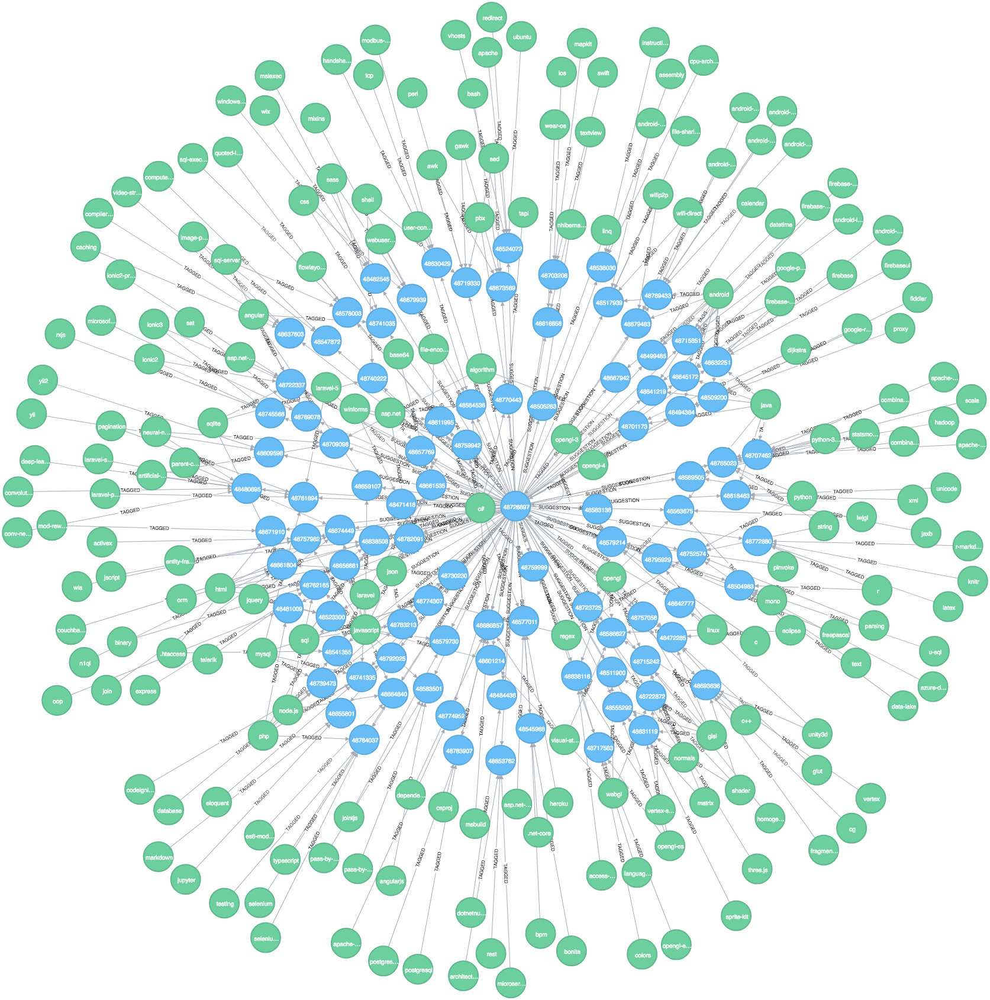

In [1]:
from IPython.display import Image
Image("Data/graph.png")

# Limitations

Currently, the main limitation would be the computer power. I was able to utilize 150,000 datapoints in the statistics; however, running machine learning on this many data points caused the memory to be overloaded. Within this dataset, there were certain assumptions made as well. The user noted their own age and location, which could be slightly off. For example, someone could use a fake location and age to avoid being identified. 

# Further Research
I could have an extra tag for the type of software it is. For example, Java and Python are programming languages while MangoDB and Postgresql are databases. <br>
<br>
The data I have was queried through the stack exchange data explorer. Instead, I could introduce the StackOverflow API to pull and query data. <br>
Because of the memory intensive calculations and visualizations, implementing big data tools such as dask and docker could allow for more efficient calculations and thus give more accurate results. In addition, implementing these type of tools would also allow for recommendations for multiple users, allowing for evaluating purposes. <br>
<br>
Providing a dashboard of some kind where the predictions could be tagged as correct or incorrect would greatly improve the recommendations as well. <br>


# Client Recommendations

In order to improve the tag recommendations, I have provided three different methods to provide tags.

# Code

In [2]:
import pandas as pd
import re

In [3]:
import os
import sys

os.environ['PYSPARK_PYTHON'] = sys.executable
os.environ['PYSPARK_DRIVER_PYTHON'] = sys.executable

In [4]:
import pyspark
number_cores = 8
memory_gb = 32
conf = (
    pyspark.SparkConf()
        .setMaster('local[{}]'.format(number_cores))
        .set('spark.driver.memory', '{}g'.format(memory_gb))
)
sc = pyspark.SparkContext(conf=conf)

In [5]:
from pyspark.sql import SQLContext
sql = SQLContext(sc)

In [6]:
from pyspark.sql.types import *

schema = StructType([StructField('user_id', IntegerType(),True),
                     StructField('user_location', StringType(),True),
                     StructField('user_age',IntegerType(),True),
                     StructField('user_reputation',IntegerType(),True),
                     StructField('post_id',IntegerType(),True),
                     StructField('post_score',IntegerType(),True),
                     StructField('post_views',IntegerType(),True),
                     StructField('post_creation_date',StringType(),True),
                     StructField('tags',StringType(),True),
                     StructField('title',StringType(),True),
                     StructField('body',StringType(),True)
                    ])

In [7]:
df10 = pd.read_csv('/project/stack_overflow/Data/Query/QueryResults (10).csv')
df9 = pd.read_csv('/project/stack_overflow/Data/Query/QueryResults (9).csv')
df8 = pd.read_csv('/project/stack_overflow/Data/Query/QueryResults (8).csv')
df = pd.concat([df10,df9,df8],axis=0)

In [8]:
df.head(5)

,body,post_creation_date,post_id,post_score,post_views,tags,title,user_age,user_id,user_location,user_reputation
0,<p>Using Couchbase 5.0 and its Java client 2.0...,2017-11-07 23:59:06,47169384,2,743,<java><sdk><nosql><couchbase><bucket>,Couchbase Bucket authentication error,39,882150,"Badajoz, Spain",1557
1,<p>I have a <code>UITableView</code> which und...,2017-11-07 23:58:07,47169380,3,262,<ios><swift><uitableview><batch-updates>,"Section headers ""bounce"" when UITableView is r...",46,992484,"Melbourne, Australia",286751
2,<p>I need to list a few rows from a specific q...,2017-11-07 23:54:53,47169347,0,107,<datetime><cakephp><cakephp-3.0>,Cakephp 3 not respecting database DateTime,25,6421759,"Santa Fe, Argentina",586
3,<p>I'm having a hard time with this approach s...,2017-11-07 23:52:33,47169322,0,40,<c#><group-by><linq-to-objects>,How to Iterate over grouped items and compare ...,29,1775732,Brazil,15
4,"<p>Ok, I might be punching above my pay grade ...",2017-11-07 23:49:40,47169299,0,56,<entity-framework><asp.net-core>,Entity Framework Set with Generic Class,48,99392,Arizona,3262


In [9]:
schema = StructType([StructField('body',StringType(),True),
                     StructField('post_creation_date',StringType(),True),
                     StructField('post_id',IntegerType(),True),
                     StructField('post_score',IntegerType(),True),
                     StructField('post_views',IntegerType(),True),
                     StructField('tags',StringType(),True),
                     StructField('title',StringType(),True),
                     StructField('user_age',IntegerType(),True),
                     StructField('user_id', IntegerType(),True),
                     StructField('user_location', StringType(),True),
                     StructField('user_reputation',IntegerType(),True),
                    ])


In [10]:
df = sql.createDataFrame(df,schema=schema)

In [11]:
df.take(1)

[Row(body='<p>Using Couchbase 5.0 and its Java client 2.0.3, I have the following error.</p>\n\n<p>Just following these instructions to open a bucket:</p>\n\n<p><a href="https://developer.couchbase.com/documentation/server/current/sdk/java/managing-connections.html" rel="nofollow noreferrer">https://developer.couchbase.com/documentation/server/current/sdk/java/managing-connections.html</a></p>\n\n<p>As explained, with a basic local configuration, it\'s just a matter of two lines of code:</p>\n\n<pre><code>Cluster cluster = CouchbaseCluster.create();\nBucket bucket = cluster.openBucket("hero");\n</code></pre>\n\n<p>That should open the localhost cluster (it actually does) and afterwards open a bucket called "hero", which actually exists in my Couchbase server.</p>\n\n<p>Nevertheless, I keep getting the following error:</p>\n\n<pre><code>2017-11-08 00:40:25.546 ERROR 1077 --- [nio-8080-exec-1] o.a.c.c.C.[.[.[/].[dispatcherServlet]    : Servlet.service() for servlet [dispatcherServlet] in

In [12]:
df = df.withColumn("post_creation_date", df["post_creation_date"].cast(TimestampType()))

In [13]:
from pyspark.sql.functions  import to_date
df = df.withColumn("post_creation_date", to_date(df["post_creation_date"],'yyyy-MM-dd'))

In [14]:
df.take(1)

[Row(body='<p>Using Couchbase 5.0 and its Java client 2.0.3, I have the following error.</p>\n\n<p>Just following these instructions to open a bucket:</p>\n\n<p><a href="https://developer.couchbase.com/documentation/server/current/sdk/java/managing-connections.html" rel="nofollow noreferrer">https://developer.couchbase.com/documentation/server/current/sdk/java/managing-connections.html</a></p>\n\n<p>As explained, with a basic local configuration, it\'s just a matter of two lines of code:</p>\n\n<pre><code>Cluster cluster = CouchbaseCluster.create();\nBucket bucket = cluster.openBucket("hero");\n</code></pre>\n\n<p>That should open the localhost cluster (it actually does) and afterwards open a bucket called "hero", which actually exists in my Couchbase server.</p>\n\n<p>Nevertheless, I keep getting the following error:</p>\n\n<pre><code>2017-11-08 00:40:25.546 ERROR 1077 --- [nio-8080-exec-1] o.a.c.c.C.[.[.[/].[dispatcherServlet]    : Servlet.service() for servlet [dispatcherServlet] in

In [15]:
df.printSchema()

root
 |-- body: string (nullable = true)
 |-- post_creation_date: date (nullable = true)
 |-- post_id: integer (nullable = true)
 |-- post_score: integer (nullable = true)
 |-- post_views: integer (nullable = true)
 |-- tags: string (nullable = true)
 |-- title: string (nullable = true)
 |-- user_age: integer (nullable = true)
 |-- user_id: integer (nullable = true)
 |-- user_location: string (nullable = true)
 |-- user_reputation: integer (nullable = true)



In [16]:
print(df['post_id'][0])

Column<b'post_id[0]'>


In [17]:
df_loc10 = pd.read_csv('/project/stack_overflow/Data/geocoded/geocoded_QueryResults_(10).csv')

In [18]:
df10['country'] = df_loc10['country']
df10['input_string'] = df_loc10['input_string']

In [19]:
df_loc = pd.read_csv('/project/stack_overflow/Data/geocoded/geocoded_QueryResults_(9).csv')
df_loc2 = pd.read_csv('/project/stack_overflow/Data/geocoded/geocoding_locations.csv')

df_loc = pd.concat([df_loc,df_loc2,df10]).reset_index(drop=True)

In [20]:
df_loc = df_loc.loc[:,['country','input_string']]

In [21]:
df_loc['country'].fillna('Unknown').head()

0            India
1    United States
2            Egypt
3            Italy
4    United States
Name: country, dtype: object

In [22]:
pandas_df = df.toPandas().join(df_loc)

In [23]:
pandas_df['tags'] = [x.split('><') for x in pandas_df['tags']]

In [24]:
def clean_up(df):
    pattern = re.compile("'")
    df['tags'] = [re.sub(pattern,'',str(x)) for x in df['tags']]
    pattern = re.compile("\[|\]")
    df['tags'] = [re.sub(pattern,'',str(x)) for x in df['tags']]
    pattern = re.compile("\<|\>")
    df['tags'] = [re.sub(pattern,'',str(x)) for x in df['tags']]
    df['tags'] = [x.split(', ') for x in df['tags']]
    return df

def flatten_df(df):
    try:
        s = df.apply(lambda x: pd.Series(x['tags']),axis=1).stack().reset_index(level=1, drop=True)
        s.name = 'tag'
        df = df.drop('tags', axis=1).join(s)
    except:
        df = df.toPandas()
        s = df.apply(lambda x: pd.Series(x['tags']),axis=1).stack().reset_index(level=1, drop=True)
        s.name = 'tag'
        df = df.drop('tags', axis=1).join(s)
    return df

In [25]:
pandas_df = clean_up(pandas_df)

In [26]:
flattened_pandas_df = flatten_df(pandas_df)

In [27]:
flattened_pandas_df.groupby('tag').size().nlargest(20).sort_values(ascending=False)

tag
javascript    18052
java          11582
python        10970
android       10763
c#             9818
php            9376
html           6043
ios            5660
angular        5490
jquery         5344
node.js        5013
css            4518
swift          3804
mysql          3746
c++            3685
reactjs        3416
sql            2930
json           2640
arrays         2416
typescript     2364
dtype: int64

In [28]:
def removing_outliers(df,column):
    import numpy as np
    q95, q5 = np.percentile(plot_df[column].dropna(), [95 ,5])
    iqr = q95 - q5

    min = q95 - (iqr*1.5)
    max = q95 + (iqr*1.5)
    return min,max

In [29]:
plot_df = pandas_df
min_age, max_age = removing_outliers(plot_df,'user_age')
min_rep, max_rep = removing_outliers(plot_df,'user_reputation')
min_score, max_score = removing_outliers(plot_df,'post_score')
min_views, max_views = removing_outliers(plot_df,'post_views')

In [30]:
import plotly.offline as offline
import plotly.tools as tls
import matplotlib.pyplot as plt
offline.init_notebook_mode()


fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=4, ncols=1,figsize=(10,10))
                                         
ax1.set_title('User Age Distribution')
ax1.hist(plot_df['user_age'], bins=100)
min_age, max_age = removing_outliers(plot_df,'user_age')
ax2.set_title('User Reputation Distribution')
ax2.hist(plot_df['user_reputation'], bins=200)
ax3.set_title('Post Scores Distribution')
ax3.hist(plot_df['post_score'], bins=5000)
ax3.set_xlim(min_score,max_score)
ax4.set_title('Post Views Distribution')
ax4.hist(plot_df['post_views'], bins=10000)
ax4.set_xlim(0, max_views)
plt.subplots_adjust(hspace=0.6)

plotly_fig = tls.mpl_to_plotly( fig )
plot_url = offline.iplot(plotly_fig)

In [31]:
import plotly.offline as offline
import plotly.graph_objs as go

offline.init_notebook_mode()

data = dict(type='choropleth',
locations = plot_df.groupby('country').size().index,
locationmode = 'country names', z = plot_df.groupby('country').size(), colorbar = {'title':'Posts'},
colorscale='Greens',reversescale=True)

layout = dict(title='Number of posts in StackOverFlow',
geo = dict(showframe = True, projection={'type':'Mercator'}))
choromap = go.Figure(data = [data], layout = layout)
offline.iplot(choromap, validate=False)

In [32]:
plot_df['country'].value_counts().nlargest(20)

India             32632
United States     26181
United Kingdom     8676
Germany            6454
France             3927
Canada             3618
Brazil             3382
Netherlands        3326
Pakistan           3060
Italy              2874
Russia             2866
Australia          2404
Spain              2316
Poland             2073
Iran               1954
Ukraine            1810
Israel             1570
China              1564
Bangladesh         1560
Turkey             1520
Name: country, dtype: int64

In [33]:
import plotly.offline as offline
import plotly.graph_objs as go
from plotly.graph_objs import *

offline.init_notebook_mode()

data = Data([Bar(x=plot_df.groupby('post_creation_date').count().index,
                 y = plot_df.groupby('post_creation_date').count()['user_id']
                )])
layout = go.Layout(
    width = 800,
    height = 500,
    title = "Number of Posts Per Day",
    xaxis = dict(
      title = "Date",
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=3,
                     label='3m',
                     step='month',
                     stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(),
        type='date'
    ),
    yaxis = dict(
      title = "Number of Posts"
        
    ),
      showlegend= False
)

fig = Figure(data=data, layout=layout)
offline.iplot(fig)


In [34]:
flatten_plot_df = flatten_df(plot_df)

In [35]:
filtered_flatten_plot_df = flatten_plot_df[flatten_plot_df['tag'].isin(flatten_plot_df.groupby(['tag']).size().nlargest(10).index)]

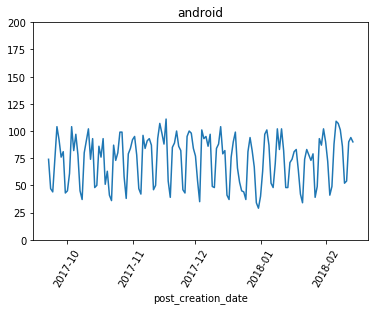

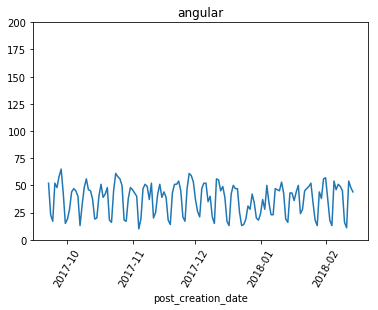

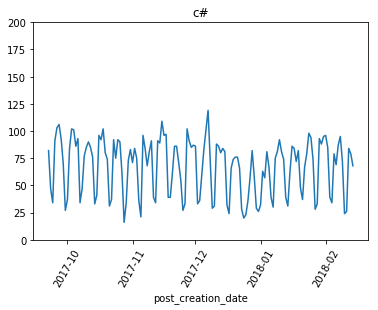

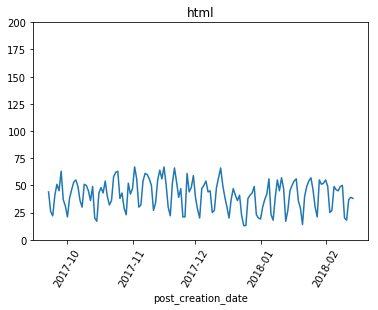

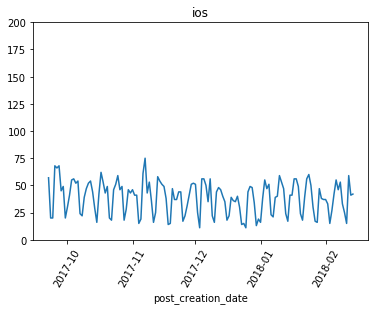

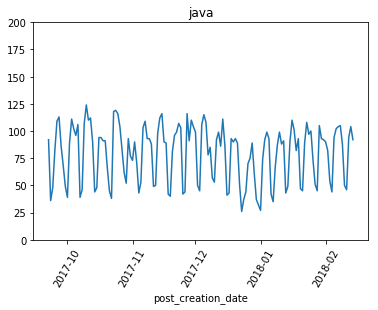

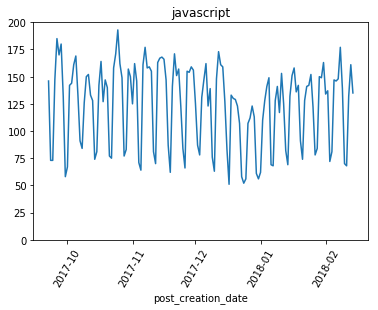

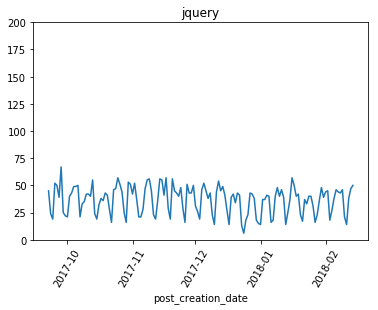

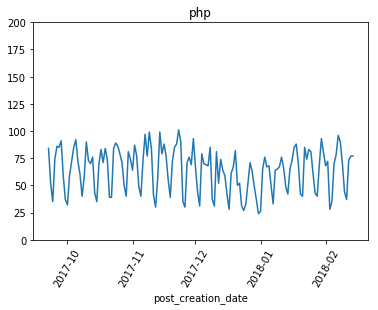

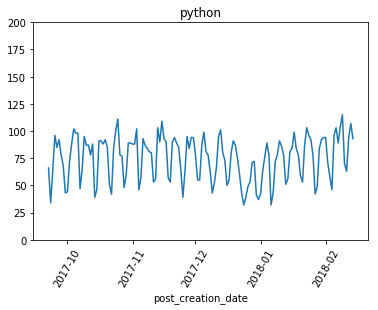

In [36]:
for index,group in filtered_flatten_plot_df.groupby(['tag']):
    group.groupby('post_creation_date').count().plot(y='post_id',title=index,rot='60',legend=False,ylim=(0,200))

## Statistics

In [37]:
pandas_df = pandas_df.drop(['level_0','index'],axis=1,errors='ignore')

In [40]:
pandas_df.drop(['post_id','user_id'],axis=1).describe()

,post_score,post_views,user_age,user_reputation
count,150000.000000,150000.000000,150000.000000,1.500000e+05
mean,0.558020,145.574493,30.252747,2.348137e+03
std,6.006465,1087.404256,8.942015,1.196191e+04
min,-19.000000,1.000000,13.000000,1.000000e+00
25%,0.000000,37.000000,25.000000,5.300000e+01
50%,0.000000,61.000000,28.000000,3.200000e+02
75%,1.000000,124.000000,34.000000,1.241000e+03
max,2200.000000,332291.000000,148.000000,1.026718e+06


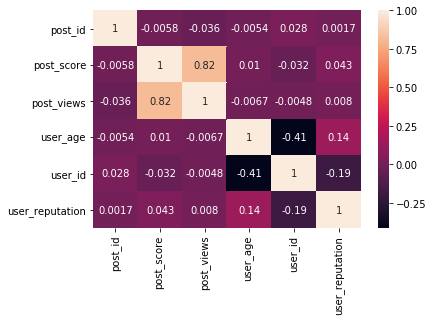

In [41]:
import seaborn as sns
import matplotlib.pyplot as plt
corr = pandas_df.corr()
sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values,
            annot=True)
plt.show()

Text(336.971,0.5,"User's Reputation")

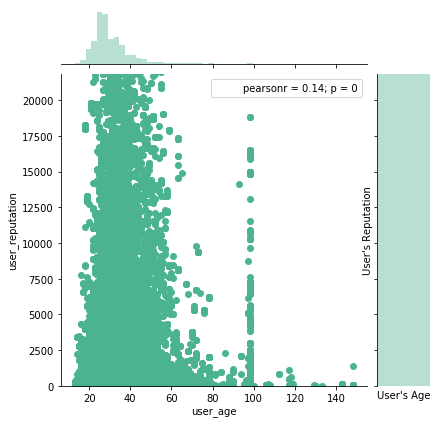

In [42]:
import seaborn as sns
sns.jointplot(pandas_df['user_age'], pandas_df['user_reputation'],color="#4CB391")
plt.xlim(min_age,max_age)
plt.ylim(0,max_rep)
plt.xlabel("User's Age")
plt.ylabel("User's Reputation")

Text(393.8,0.5,"Post's Score")

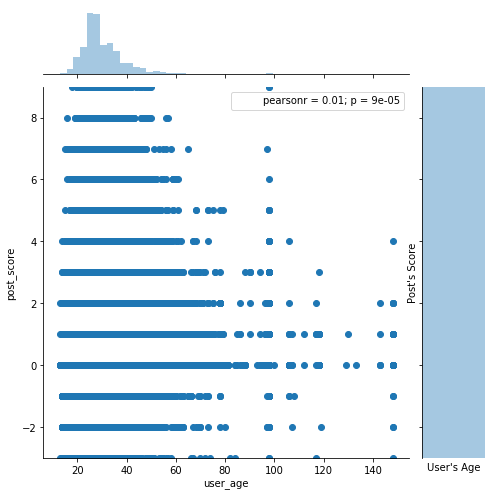

In [43]:
sns.jointplot(pandas_df['user_age'], pandas_df['post_score'], size=7)
plt.xlim(min_age,max_age)
plt.ylim(min_score,max_score)
plt.xlabel("User's Age")
plt.ylabel("Post's Score")

Text(393.8,0.5,"Post's Score")

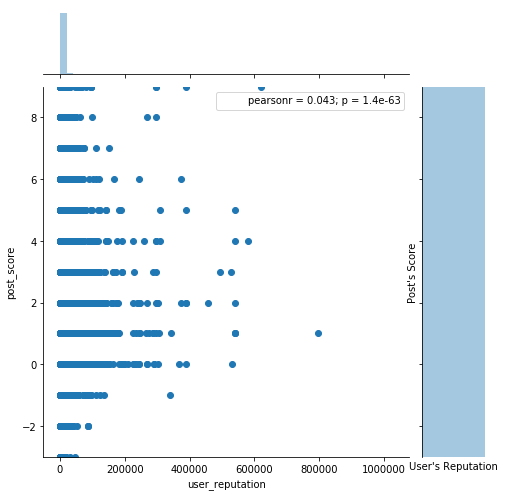

In [44]:
sns.jointplot(pandas_df['user_reputation'], pandas_df['post_score'], size=7)
plt.xlim(0,max_rep)
plt.ylim(min_score,max_score)
plt.xlabel("User's Reputation")
plt.ylabel("Post's Score")

## Machine Learning

I am first going to make predictions using collaborative filtering. Collaborative filtering requires a user_id or post_id, item_id or tag_id, and a rating. The recommendations are made based upon the ratings. 

In [45]:
my_schema = StructType([StructField('body',StringType(),True),
                     StructField('post_creation_date',StringType(),True),
                     StructField('post_id',IntegerType(),True),
                     StructField('post_score',IntegerType(),True),
                     StructField('post_views',IntegerType(),True),
                     StructField('tags',StringType(),True),
                     StructField('title',StringType(),True),
                     StructField('user_age',IntegerType(),True),
                     StructField('user_id', IntegerType(),True),
                     StructField('user_location', StringType(),True),
                     StructField('user_reputation',IntegerType(),True),
                     StructField('country',StringType(),True),
                     StructField('input_string',StringType(),True),
                    ])

In [46]:
pandas_df = sql.createDataFrame(pandas_df,schema=my_schema)

In [47]:
recommend_df = pandas_df.limit(5000).toPandas()

In [48]:
recommend_df = clean_up(recommend_df)

In [49]:
pattern= re.compile('<p>')
recommend_df['body'] = [re.sub(pattern,'',x) for x in recommend_df['body']]

In [50]:
flattened_recommend_df = flatten_df(recommend_df).reset_index(drop=True)

In [51]:
flattened_recommend_df['tag'] = flattened_recommend_df['tag'].astype('category')
flattened_recommend_df['tag_id'] = flattened_recommend_df['tag'].cat.codes

In [52]:
from surprise import Reader, Dataset
ratings_dict = {'itemID': list(flattened_recommend_df['tag_id']),
                'userID': list(flattened_recommend_df['post_id']),
                'rating': list(flattened_recommend_df['post_score'])}
df = pd.DataFrame(ratings_dict)
reader = Reader(rating_scale=(flattened_recommend_df['post_score'].min(), flattened_recommend_df['post_score'].max()))
data = Dataset.load_from_df(df[['userID', 'itemID', 'rating']], reader)

In [53]:
from surprise import SVD
from surprise import KNNBasic
from surprise import dump
from surprise.accuracy import rmse

sim_options = {
    'name': 'cosine',
    'user_based': False
}


algo_svd = SVD()                                                       
algo_knn = KNNBasic(k=20,sim_options=sim_options)

for trainset, testset in data.folds(): 
    algo_svd.fit(trainset)                             
    predictions_svd = algo_svd.test(testset)
    
    algo_knn.fit(trainset)
    predictions_knn = algo_knn.test(testset)
    
    rmse(predictions_svd)
    rmse(predictions_knn)                                                                           
    
    dump.dump('Data/dump_SVD', predictions_svd, algo_svd)
    dump.dump('Data/dump_KNN', predictions_knn, algo_knn)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/surprise/dataset.py:193: UserWarning:

Using data.split() or using load_from_folds() without using a CV iterator is now deprecated. 



Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.5685
RMSE: 1.2658
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.8938
RMSE: 1.7354
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.3862
RMSE: 0.9961
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.7163
RMSE: 1.4841
Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.5266
RMSE: 1.2485


In [54]:
predictions_svd, algo_svd = dump.load('./dump_SVD')
predictions_knn, algo_knn = dump.load('./dump_KNN')

df_svd = pd.DataFrame(predictions_svd, columns=['uid', 'iid', 'rui', 'est', 'details'])    
df_knn = pd.DataFrame(predictions_knn, columns=['uid', 'iid', 'rui', 'est', 'details'])    

df_svd['err'] = abs(df_svd.est - df_svd.rui)
df_knn['err'] = abs(df_knn.est - df_knn.rui)

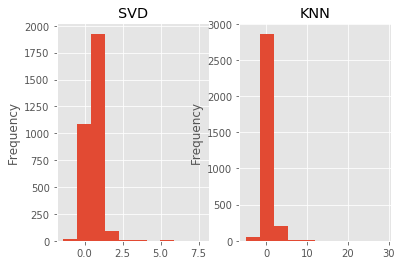

In [55]:
import matplotlib.pyplot as plt
import matplotlib
matplotlib.style.use('ggplot')

figure, (ax1, ax2) = plt.subplots(1, 2)

df_svd.est.plot(kind='hist', title='SVD', ax=ax1)
df_knn.est.plot(kind='hist', title='KNN', ax=ax2)


KNN does a lot better when I am looking at values around the mean. However, I have quite a few outliers, so I am going to go with SVD() for further analysis.

In [56]:
from surprise.prediction_algorithms.co_clustering import CoClustering
from surprise.model_selection import GridSearchCV

def frange(start, end, step):
    tmp = start
    while(tmp < end):
        yield tmp
        tmp += step  

param_grid = {'n_epochs': range(20,40,10), 'lr_all': frange(0.005,0.009,0.001),
              'reg_all': frange(0.4,0.6,0.05)}
gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=5)

gs.fit(data)

# best RMSE score
print(gs.best_score['rmse'])

# combination of parameters that gave the best RMSE score
print(gs.best_params['rmse'])

1.4308106327931465
{'n_epochs': 30, 'lr_all': 0.008, 'reg_all': 0.45}


In [57]:
import numpy as np
from collections import defaultdict
from surprise import SVD
from surprise import Dataset


def get_top_n(predictions, n=10):
    '''Return the top-N recommendation for each user from a set of predictions.

    Args:
        predictions(list of Prediction objects): The list of predictions, as
            returned by the test method of an algorithm.
        n(int): The number of recommendation to output for each user. Default
            is 10.

    Returns:
    A dict where keys are user (raw) ids and values are lists of tuples:
        [(raw item id, rating estimation), ...] of size n.
    '''

    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

algo = gs.best_estimator['rmse']


# First train an SVD algorithm on the movielens dataset.
trainset = data.build_full_trainset()
algo = gs.best_estimator['rmse']
algo.fit(trainset)

# Than predict ratings for all pairs (u, i) that are NOT in the training set.
testset = trainset.build_anti_testset()
predictions = algo.test(testset)
top_n = get_top_n(predictions[:10], n=10)

# Print the recommended items for each user
for uid, user_ratings in top_n.items():
    recommended_id = [iid for (iid, _) in user_ratings]
    print(uid, np.unique([value['tag'] for index,value in flattened_recommend_df.iterrows() if value['tag_id'] in recommended_id]))

47169221 ['.net-standard' 'find' 'firebaseui' 'gson' 'html5' 'http' 'oracle' 'sh'
 'spring-saml' 'webclient']


In [58]:
pandas_df = pandas_df.withColumn("user_id",pandas_df['user_id'].cast("integer"))
pandas_df = pandas_df.withColumn("post_score",pandas_df['post_score'].cast("float"))

In [59]:
from pyspark.sql.functions import col, split
corpus = pandas_df.limit(10000).withColumn("body", split("body", "\s+"))

In [60]:
from pyspark.ml.feature import Word2Vec
from pyspark.ml.clustering import KMeans
import numpy as np

w2v = Word2Vec(inputCol="body", outputCol="w2v") 
model = w2v.fit(corpus)
corpus = model.transform(corpus)

cost = np.zeros(30)
for k in range(2,30):
    kmeans = KMeans().setK(k).setSeed(1).setFeaturesCol("w2v")
    model = kmeans.fit(corpus.sample(False,0.8, seed=42))
    cost[k] = model.computeCost(corpus) # requires Spark 2.0 or later

In [61]:
cost = [x for x in cost if x]

Text(0,0.5,'Cost')

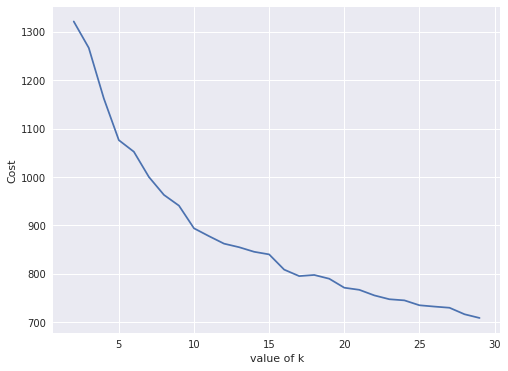

In [62]:
sns.set()
fig, ax = plt.subplots(1,1, figsize =(8,6))
ax.plot(range(2,30),cost)
ax.set_xlabel('value of k')
ax.set_ylabel('Cost')

In [63]:
def prediction_k(df,k):
    kmeans = KMeans().setK(k).setSeed(1).setFeaturesCol("w2v").setPredictionCol("prediction")
    final_model = kmeans.fit(df.sample(False,0.2, seed=42))
    df = final_model.transform(df)
    return df


In [64]:
corpus = prediction_k(corpus,10).toPandas()

In [65]:
corpus = clean_up(corpus)
flatten_corpus = flatten_df(corpus)

In [66]:
pd.crosstab(flatten_corpus.tag,flatten_corpus.prediction,margins=True)

prediction,0,1,2,3,4,5,6,7,8,9,All
tag,,,,,,,,,,,
.htaccess,3,0,12,0,5,9,0,0,0,0,29
.net,2,22,26,0,32,21,10,1,0,3,117
.net-3.0,0,0,0,0,1,0,0,0,0,0,1
.net-3.5,0,0,1,0,0,0,0,0,0,0,1
.net-4.0,0,1,0,0,0,0,0,0,0,0,1
.net-4.5,0,0,1,0,0,0,0,0,0,0,1
.net-4.7,0,0,1,0,0,0,0,0,0,0,1
.net-assembly,0,0,1,0,1,1,0,0,0,0,3
.net-core,0,6,7,0,5,10,1,1,0,1,31


In [67]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /home/sherlock/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [68]:
import pandas as pd
import nltk
import string
import os

from sklearn.metrics.pairwise import polynomial_kernel 
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem.porter import PorterStemmer

def get_recom(df):
    stemmer = PorterStemmer()
    
    try:
        df = df.limit(10000).toPandas().reset_index().drop(['level_0','index'],axis=1,errors='ignore')
    except:
        df = df.reset_index().drop(['level_0','index'],axis=1,errors='ignore')
        
    def stem_tokens(tokens, stemmer):
        stemmed = []
        for item in tokens:
            stemmed.append(stemmer.stem(item))
        return stemmed

    def tokenize(text):
        tokens = nltk.word_tokenize(text)
        stems = stem_tokens(tokens, stemmer)
        return stems    
    
    tf = TfidfVectorizer(analyzer='word', tokenizer=tokenize, ngram_range=(1, 3), min_df=0, stop_words='english')
    tfidf_matrix = tf.fit_transform(df['body'])

    cosine_similarities = polynomial_kernel(tfidf_matrix, tfidf_matrix)

    results = {}

    for idx, row in df.iterrows():
        similar_indices = cosine_similarities[idx].argsort()[:-100:-1]
        similar_items = [(cosine_similarities[idx][i], df['post_id'][i]) for i in similar_indices]

        # First item is the item itself, so remove it.
        # Each dictionary entry is like: [(1,2), (3,4)], with each tuple being (score, item_id)
        results[row['post_id']] = similar_items[1:]
    
    def item(id):
        return df.loc[df['post_id'] == id]

    # Just reads the results out of the dictionary. No real logic here.
    def recommend(item_id):
        recs = results[item_id]
        clean_df = []
        similarities = []
        clean_df = [item(rec[1]) for rec in recs]
        similarities = [rec[0] for rec in recs]
        clean_df = pd.concat(clean_df)
        clean_df['similarity'] = similarities
        return clean_df

    # Just plug in any item id here (1-500) and will give you a 100 recommendations back
    return recommend(item_id=df['post_id'][0]) 

In [69]:
df = get_recom(pandas_df)

In [70]:
df = clean_up(df).reset_index(drop=True)
flattened_df = flatten_df(df).reset_index(drop=True)
flattened_plot = flattened_df.loc[:,['post_id','tag','similarity']]
flattened_plot['original_post_id'] = pandas_df['post_id'][0]

In [71]:
from py2neo import Graph

In [72]:
graph = Graph('https://......./db/data/',user='neo4j',password='Your_password',secure=False, bolt=False)

In [73]:
q = '''CREATE INDEX ON :Post(id);'''
q1 = '''CREATE INDEX ON :Tag(name);'''
q2 = '''LOAD CSV WITH HEADERS FROM "https://raw.githubusercontent.com/sdf94/Springboard/master/plot.csv" AS row
MERGE (a:Post {id:row.original_post_id})
MERGE (b:Post {id:row.post_id}) 
MERGE (c:Tag {name:trim(row.tag)})
MERGE (a) - [:SUGGESTION {score: row.similarity}] -> (b)
MERGE (b) <- [:TAGGED] - (c)
RETURN a,b,c'''
q3 = '''MATCH (t:Tag)
RETURN t.name, SIZE((t)-[:TAGGED]->()) AS count
ORDER BY count DESC'''

In [74]:
graph.run(q)
graph.run(q1)
graph.run(q2)

In [75]:
tags_frequency = pd.DataFrame.from_records(graph.run(q3),columns=['Tags','Frequency'])
tags_frequency.head(5)

,Tags,Frequency
0,c#,13
1,javascript,12
2,android,11
3,opengl,9
4,glsl,7


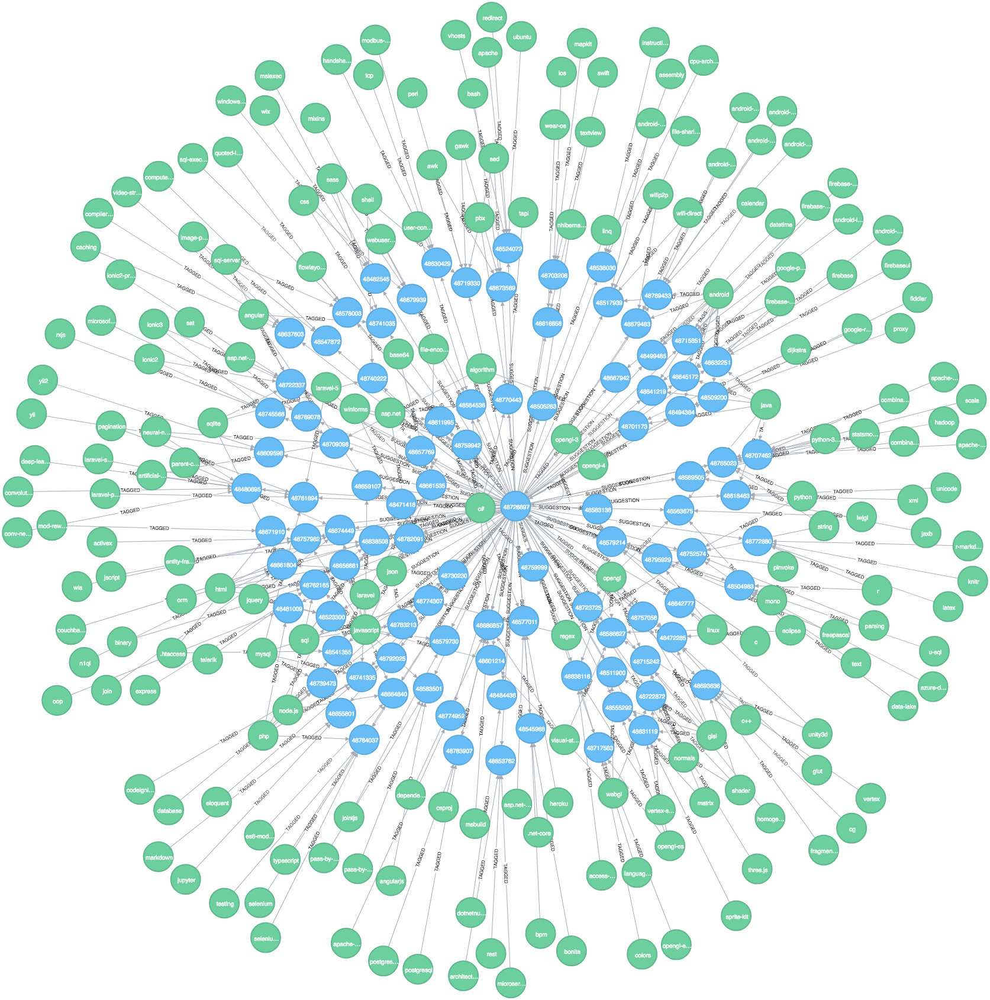

In [76]:
from IPython.display import Image
Image("Data/graph.png")